# Notebook to plan out the form of the optimal estimator

In [1]:
import numpy as np
import sys
sys.path.append('..')
import skewer_computations as skc
import os
import matplotlib.pyplot as plt
# from fake_spectra import spectra as spec
import time
%load_ext autoreload
%autoreload 2
import estimator as est
rng = np.random.default_rng(seed=315)

from forestflow.model_p3d_arinyo import ArinyoModel
from forestflow.archive import GadgetArchive3D
from lace.cosmo import camb_cosmo
from forestflow import pcross
from scipy.interpolate import interp1d

# Goal: estimate deviations from a fiducial Px spectrum

$$P_\times(z,\Delta \theta,k_\parallel) =  P_\times^{\rm
   fid}(z,\Delta \theta,k_\parallel) + \sum_\alpha ~ \Theta_\alpha(\Delta \theta) 
    ~ w^\times_\alpha(z, k_\parallel) ~ p^\times_\alpha ~ $$
    
$    w^\times_\alpha(z, k_\parallel)$ is an interpolation kernel, $ \Theta_\alpha(\Delta \theta) $ is top hat filter in transverse.  $p_\alpha = P^\times(k_\alpha) − P^\times_\mathrm{fid}(k_\alpha)$ are the cross-spectrum parameters we want to measure, i.e., the deviations from the fiducial power spectrum.

### Load the data.
We're working in pixel space

In [2]:
# set sim_name
sim_name='sim_pair_30' # other version will be 'diffSeed'
sim_dir='central'
snap_num = 6
# set phase
phase = "sim_minus"
# set axis number
axis = 1


In [3]:
# # get the measurements for this set
meas_path = "/Users/mlokken/research/lyman_alpha/data/"
separation_bin = [0.13, 0.32]
Px_info = np.load(meas_path+"snap_{:d}/Px_skewers_{:.2f}_{:.2f}_allax_allphase.npz".format(snap_num,separation_bin[0],separation_bin[1]))
Px_meas_0 = Px_info['Px']
L= Px_info['L']
Np = int(Px_info['Np'])
spacing = L/Np
kpar_meas = np.fft.rfftfreq(Np, spacing)*2*np.pi # frequency in Mpc^-1


# load the skewers as npz file
delta_x = np.load(meas_path+"snap_{:d}/delta_x/skewers_6_psim_minus_ax1_Ns768_wM0.05_sT1.0_sg1.0.npz".format(snap_num))

In [4]:
delta_flux_x = delta_x['delta_flux_x'] # these are already normalized
Np = delta_flux_x.shape[1]
L = delta_x['L_Mpc']
pix_spacing = L/Np
print("pixel spacing is", pix_spacing, "Mpc")
xpar = delta_x['xpar'] # this is still wrong for some reason, redefined below
# delta_x['los_spacing_Mpc']

delta_x.close()

pixel spacing is 0.05 Mpc


In [5]:
xpar = np.arange(0, L, pix_spacing)+pix_spacing/2.

In [6]:
Np = delta_flux_x.shape[1]
nskew = delta_flux_x.shape[0]
# means = np.mean(delta_flux_x, axis=0)
nside = np.sqrt(nskew).astype(int)
print(f"Box is {L} Mpc per side with {nside} skewers per side")
print(f"Spacing between pixels along line-of-sight = {pix_spacing} Mpc")

# bin delta_flux along line-of-sight
binsize = 5
# binsize=30

if Np%binsize != 0:
    print("Np is not divisible by binsize")
    sys.exit()
delta_flux_b, xpar_b = est.bin_spectra(delta_flux_x, xpar, binsize)
# means_b = np.mean(delta_flux_b, axis=0)

Np_b=delta_flux_b.shape[1]
pix_spacing_b = xpar_b[1]-xpar_b[0]
print(f"Spacing between pixels along line-of-sight after binning = {pix_spacing_b} Mpc")

# get the positions
xpos = np.linspace(0,L,nside)
ypos = np.linspace(0,L,nside)
print("spacing between neighboring skewers is {:.2f} Mpc".format(xpos[1]-xpos[0]))
positions = np.array([[x,y] for x in xpos for y in ypos])
subsel=True
nsub=5000
if subsel:
    randoms = rng.choice(len(positions), size=nsub)
    sel = np.zeros(len(positions), dtype=bool)
    sel[randoms] = True
else:
    sel = np.ones(len(positions), dtype=bool)
positions_sel = np.copy(positions)
positions_sel[~sel] = np.nan
delta_flux_x[~sel] = np.nan
delta_flux_b[~sel] = np.nan


# reshape into a grid
delta_flux_x = np.reshape(delta_flux_x, (int(nside), int(nside), Np))
delta_flux_b = np.reshape(delta_flux_b, (int(nside), int(nside), Np_b))
position_grid = np.reshape(positions_sel, (int(nside), int(nside), 2))

Box is 67.5 Mpc per side with 768 skewers per side
Spacing between pixels along line-of-sight = 0.05 Mpc
Number of bins: 270


Spacing between pixels along line-of-sight after binning = 0.25000000000000006 Mpc
spacing between neighboring skewers is 0.09 Mpc


0.022810071876795002
0.02281007187679499
0.04384455851887168
0.04384455851887168
-0.0005566723049617887
-0.0005566723049617834


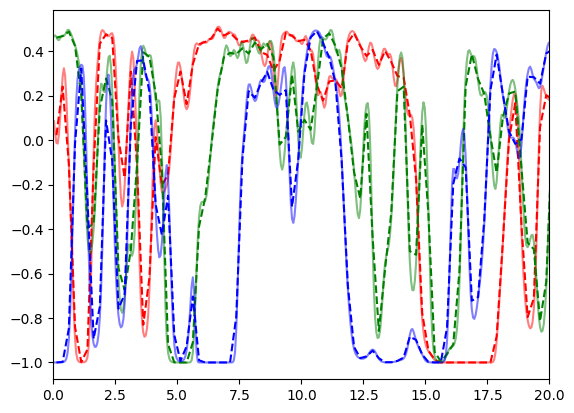

plotted 3 spectra


In [7]:
colors=['r','g','b','c','m','y','k']
# plot the spectra that are not nan
counter = 0

for i in range(nside//2):
    for j in range(nside//2):
        if np.isnan(delta_flux_x[i,j]).any():
            continue
        else:
            if counter<3:
                plt.plot(xpar, delta_flux_x[i,j], label='unbinned', color=colors[counter%7], alpha=.5)
                plt.plot(xpar_b, delta_flux_b[i,j], label='binned', color=colors[counter%7], linestyle='--', alpha=1)
                # plt.plot(xpar, delta_flux_x[i,j])
                counter += 1
                print(np.mean(delta_flux_x[i,j]))
                print(np.mean(delta_flux_b[i,j]))
plt.xlim([0,20])
# plt.legend()
plt.show()
print(f"plotted {counter} spectra")

Our sub-selected spectra are distributed randomly across the plane:

Text(0, 0.5, 'y [Mpc]')

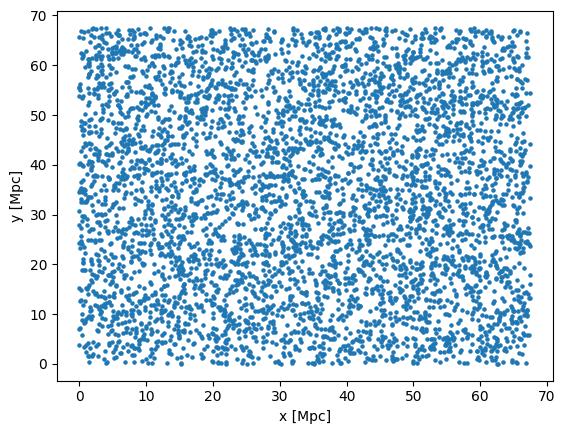

In [8]:
plt.scatter(positions_sel[:,0], positions_sel[:,1], s=5)
plt.xlabel("x [Mpc]")
plt.ylabel("y [Mpc]")

# Run the algorithm

### Choose the $k$ binning

In [9]:
# get the kpar that will correspond to the xpar
kpar_b = np.fft.rfftfreq(Np_b, pix_spacing_b)*2*np.pi # frequency in Mpc^-1
kpar   = np.fft.rfftfreq(Np, pix_spacing)*2*np.pi # frequency in Mpc^-1

In [10]:
# make a set of bins with kpar[1:] as centers
kbin_est = [[kp-(kpar_b[1]-kpar_b[0])/2, kp+(kpar_b[1]-kpar_b[0])/2] for kp in kpar_b]
print(kpar_b[:10])
print(kbin_est[:10])

[0.         0.09308423 0.18616845 0.27925268 0.37233691 0.46542113
 0.55850536 0.65158959 0.74467381 0.83775804]
[[-0.04654211338651545, 0.04654211338651545], [0.04654211338651545, 0.13962634015954634], [0.13962634015954634, 0.23271056693257725], [0.23271056693257722, 0.3257947937056081], [0.32579479370560815, 0.418879020478639], [0.418879020478639, 0.5119632472516699], [0.5119632472516699, 0.6050474740247008], [0.6050474740247007, 0.6981317007977317], [0.6981317007977317, 0.7912159275707626], [0.7912159275707625, 0.8843001543437935]]


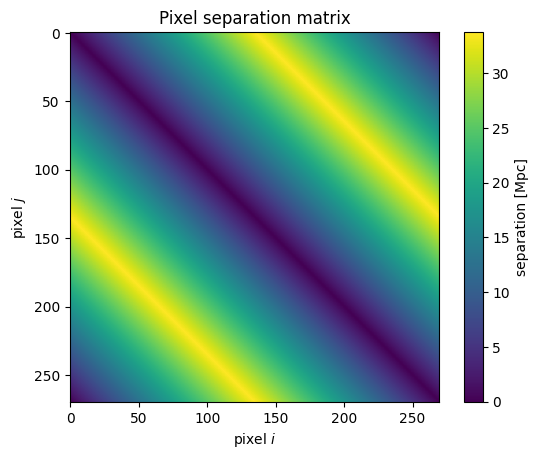

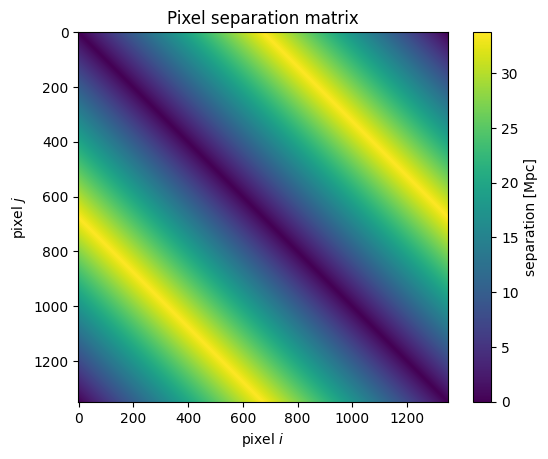

<Figure size 640x480 with 0 Axes>

In [11]:
delta_x_matrix = est.make_delta_x_matrix(L, Np, xpar)
delta_x_matrix_binned = est.make_delta_x_matrix(L, Np_b, xpar_b)
plt.imshow(delta_x_matrix_binned)
plt.title("Pixel separation matrix")
plt.xlabel(r"pixel $i$")
plt.ylabel(r"pixel $j$")
plt.colorbar(label="separation [Mpc]")
plt.show()
plt.clf()
plt.imshow(delta_x_matrix)
plt.title("Pixel separation matrix")
plt.xlabel(r"pixel $i$")
plt.ylabel(r"pixel $j$")
plt.colorbar(label="separation [Mpc]")
plt.show()
plt.clf()

In [12]:
print("We can only expect to measure up to ", kpar_b[-1], np.pi/pix_spacing_b, "the Nyquist frequency which should be half the sampling frequency, and down to", kpar_b[1], 2*np.pi/L, "the fundamental frequency")

We can only expect to measure up to  12.566370614359169 12.566370614359169 the Nyquist frequency which should be half the sampling frequency, and down to 0.0930842267730309 0.09308422677303091 the fundamental frequency


Text(0.5, 0, 'k [Mpc^-1]')

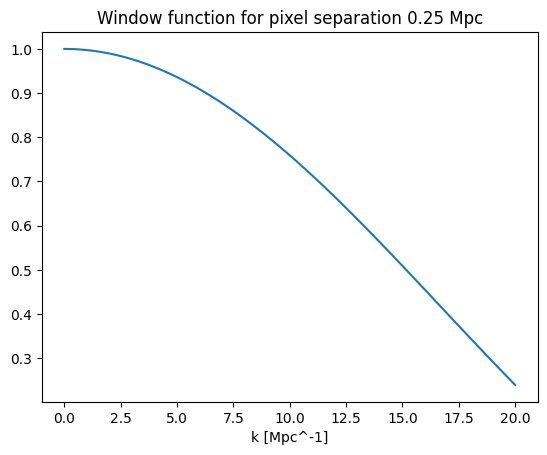

In [13]:
rand_k = np.linspace(0,20,100)
plt.plot(rand_k, est.w_k(rand_k, pix_spacing_b))
plt.title("Window function for pixel separation {:.2f} Mpc".format(pix_spacing_b))
plt.xlabel("k [Mpc^-1]")

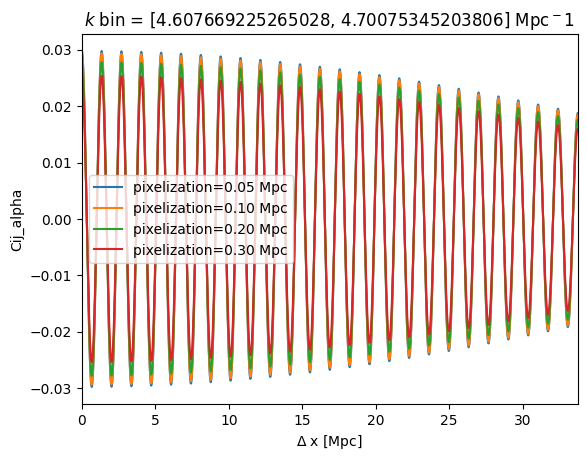

In [14]:
kbin = kbin_est[50]
Nk_full = 100000
kmax = 200
kpar_range_full = np.linspace(0, kmax, Nk_full)
kspacing_full = kmax / Nk_full
for pixelization in [pix_spacing, pix_spacing*2, pix_spacing*4, pix_spacing*6]:
    f_k = est.w_k(kpar_range_full, pixelization) ** 2
    # set the function to zero outside the kbin
    f_k[kpar_range_full > kbin[1]] = 0
    f_k[kpar_range_full < kbin[0]] = 0

    # plt.plot(kpar_range_full, f_k)
    # plt.xlabel("kpar")
    # plt.ylabel("$W_k^2$")
    # plt.axvline(kbin[0], color="black", linestyle="--")
    # plt.axvline(kbin[1], color="black", linestyle="--")
    # plt.xlim([0, 10])
    # plt.show()
    # plt.clf()
    f_x_full = (
        np.fft.irfft(f_k) * Nk_full * kspacing_full / (np.pi) 
    )  # into units of Mpc-1 ?
    delta_x_spacing = np.pi / (kpar_range_full[-1] - kpar_range_full[0]) # something wrong with this line?
    # print(delta_x_spacing, "compared to Nyquist frequency", np.pi/kmax)
    Nx = 2 * (Nk_full - 1)
    x = np.arange(Nx) * delta_x_spacing
    plt.plot(x, f_x_full, label="pixelization={:.2f} Mpc".format(pixelization))
plt.xlim([0, np.amax(delta_x_matrix)])
plt.xlabel(r"$\Delta$ x [Mpc]")
plt.ylabel("Cij_alpha")
plt.title(f"$k$ bin = {kbin} Mpc$^{-1}$")
plt.legend()

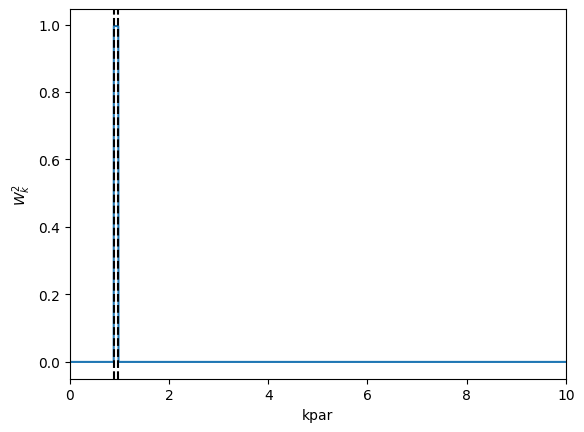

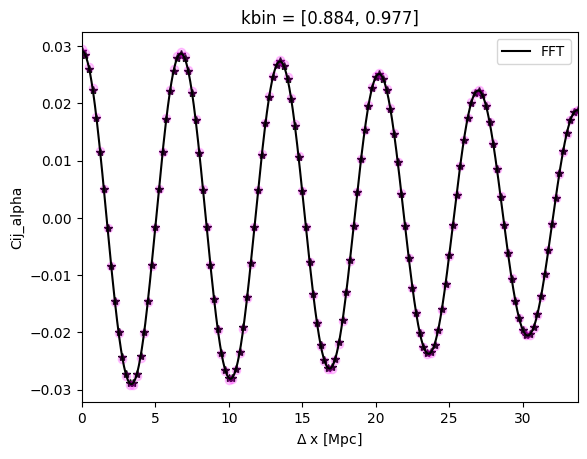

In [15]:
Cij_alpha_matrix = est.cij_alpha(Np_b, kbin_est[10], delta_x_matrix_binned, pix_spacing_b, plot=True)


# Define the first global weighting matrix by setting the fiducial Px for this separation.
However, if following F-R+18, the weighting matrix will be P1D at Delta-theta = 0 and 0 everywhere else.
So, we don't actually need to make the Px predictions. The following few boxes will be hidden.

In [16]:

path_program = "/Users/mlokken/research/lyman_alpha/software/ForestFlow/"

folder_lya_data = path_program + "data/best_arinyo/"

Archive3D = GadgetArchive3D(
    base_folder=path_program[:-1],
    folder_data=folder_lya_data,
    force_recompute_plin=False,
    average="both",
)

In [17]:
# set snapnum
central = Archive3D.get_testing_data("mpg_central")
zs = np.array([central[snap_num]['z']]) 

k3d_Mpc = central[snap_num]['k3d_Mpc']
mu3d = central[snap_num]['mu3d']
p3d_Mpc = central[snap_num]['p3d_Mpc']
Plin = central[snap_num]['Plin']

k1d_Mpc = central[snap_num]['k_Mpc']
p1d_Mpc = central[snap_num]['p1d_Mpc']

arinyo_params = central[snap_num]['Arinyo'] # best-fitting Arinyo params
cosmo_params  = central[snap_num]['cosmo_params']

print(zs)
arinyo_params

[3.]


{'bias': -0.2265946739714242,
 'beta': 1.2248241556400337,
 'q1': 0.5508070368332233,
 'kvav': 0.7735041489709146,
 'av': 0.5316646888234277,
 'bv': 1.841648720663841,
 'kp': 13.45975658765607,
 'q2': 0.1882466279205535}

In [18]:
cosmo = camb_cosmo.get_cosmology_from_dictionary(cosmo_params)
camb_results = camb_cosmo.get_camb_results(cosmo, zs=zs, camb_kmax_Mpc=1000)
arinyo = ArinyoModel(cosmo=cosmo, camb_results=camb_results, zs=zs, camb_kmax_Mpc=1000)
p1d = arinyo.P1D_Mpc(zs[0], np.linspace(0,10,20), parameters=arinyo_params) # get P1D at target z
# plt.plot(np.linspace(0,10,20), p1d)
# R2 = separation_bins[1]
# R1 = separation_bins[0]
# rperp_choice = 2/3. * (R2**3-R1**3)/(R2**2-R1**2)
# print(rperp_choice)
# rperp_pred,Px_per_kpar_pred = pcross.Px_Mpc_detailed(kpar[1:66],
# arinyo.P3D_Mpc,
# zs[0],
# rperp_choice=[rperp_choice],
# P3D_mode='pol',
# min_kperp=10**-3,
# nkperp=2**12,
# **{'pp':arinyo_params})

Define the bin we are going to measure.

Plotting separations for bin [0.13, 0.32].
11


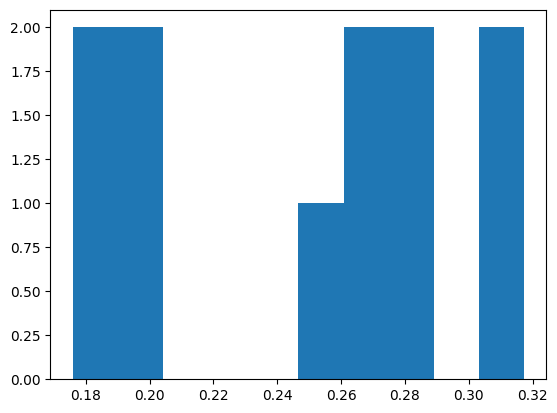

In [19]:
distances = np.linalg.norm(positions-[0,0], axis=1)
dgrid = distances.reshape(position_grid.shape[0:2])

s=0
sbin = [separation_bin[0],separation_bin[1]]
m_offsets, n_offsets = skc.offsets_inbin(positions, position_grid.shape[0:2],sbin)

print(f"Plotting separations for bin {sbin}.")


dists_remain = []
for i in range(len(m_offsets)):
    dists_remain.append(dgrid[m_offsets[i], n_offsets[i]])
plt.hist(dists_remain)
print(len(dists_remain))

In [20]:
# # compare Cij_alpha to Cij_alpha_approx
# kbin = [kpar_b[2], kpar_b[3]]
# Cij_alpha_matrix = Cij_alpha(Np_b, kpar_matrix_binned, kbin, delta_x_matrix_binned, pix_spacing_b)
# Cij_alpha_matrix_approx = Cij_alpha_approx(Np_b, kpar_matrix_binned, kbin, delta_x_matrix_binned, pix_spacing_b)
# plt.imshow(Cij_alpha_matrix)
# plt.colorbar()
# plt.title("Cij_alpha")
# plt.show()
# plt.imshow(Cij_alpha_matrix_approx)
# plt.colorbar()
# plt.title("Cij_alpha_approx")
# plt.show()
# plt.imshow(Cij_alpha_matrix-Cij_alpha_matrix_approx)
# plt.colorbar()
# plt.title("Difference")
# plt.show()

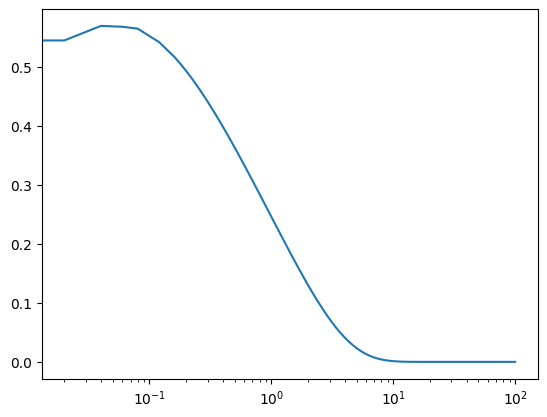

In [21]:
plt.semilogx(np.linspace(0,100,5000), arinyo.P1D_Mpc(zs[0], np.linspace(0,100,5000), parameters=arinyo_params))

In [22]:
Leff=1000
Np_fine=40000
xfine=np.linspace(0.0,Leff,Np_fine)
spacing_fine=Leff/Np_fine
kfine = np.fft.rfftfreq(Np_fine, spacing_fine)*2*np.pi
p1d_fine = arinyo.P1D_Mpc(zs[0], kfine, parameters=arinyo_params)
# for testing @ z=2.2:
# arinyo_params = central[9]['Arinyo'] # best-fitting Arinyo params
# camb_results = camb_cosmo.get_camb_results(cosmo, zs=[2.2], camb_kmax_Mpc=1000)
# p1d_fine = ArinyoModel(cosmo=cosmo, camb_results=camb_results, zs=[2.2], camb_kmax_Mpc=1000).P1D_Mpc(2.2, kfine, parameters=arinyo_params)

print(len(p1d_fine))
xi_fid = np.fft.irfft(p1d_fine) / spacing_fine # to cancel the Mpc. Might just be * Np_fine, not sure
# normalize
# pix_spacing_b/Np_b


20001


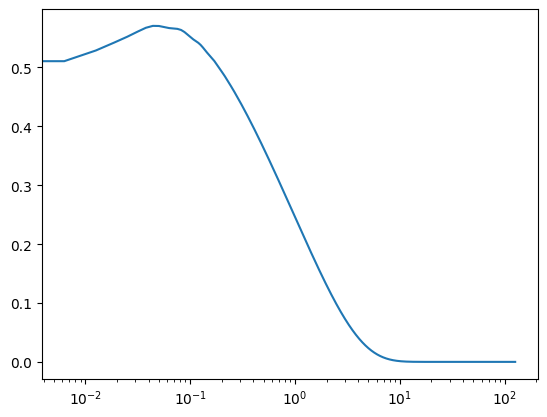

In [23]:
plt.semilogx(kfine, p1d_fine)

Text(0, 0.5, '$\\xi$')

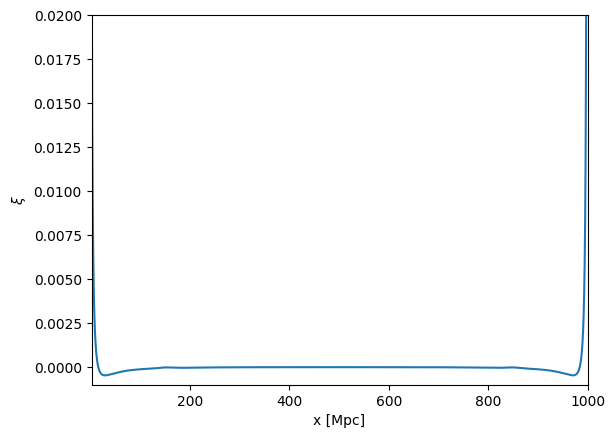

In [24]:
plt.plot(xfine, xi_fid)
# plt.xlim([10**-2.5,300])
plt.xlim([2.14, 1000])
plt.ylim([-.001,0.02])
plt.xlabel("x [Mpc]")
plt.ylabel(r"$\xi$")

In [25]:
where_200Mpc = np.where(xfine>200)[0]
xi_fid[where_200Mpc] = xi_fid[where_200Mpc[0]]
# make a function of it
xi_fid_func = interp1d(xfine, xi_fid, kind='slinear', fill_value='extrapolate')

Text(0, 0.5, '$\\xi$')

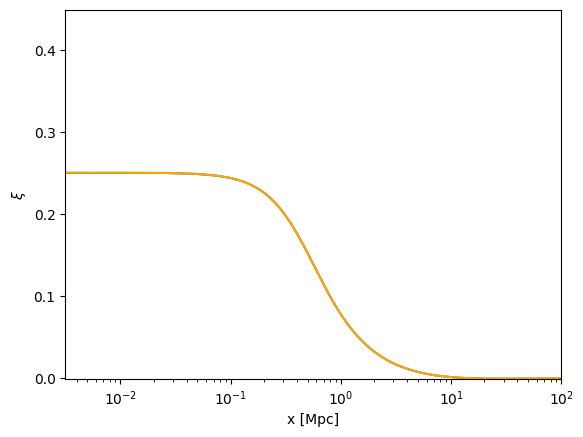

In [26]:
plt.semilogx(xfine, xi_fid)
plt.semilogx(np.logspace(-3,3,1000), xi_fid_func(np.logspace(-3,3,1000)), color='orange')
plt.xlim([10**-2.5,10**2])
plt.ylim([-.001,0.45])
plt.xlabel("x [Mpc]")
plt.ylabel(r"$\xi$")

Text(0, 0.5, '$\\xi$')

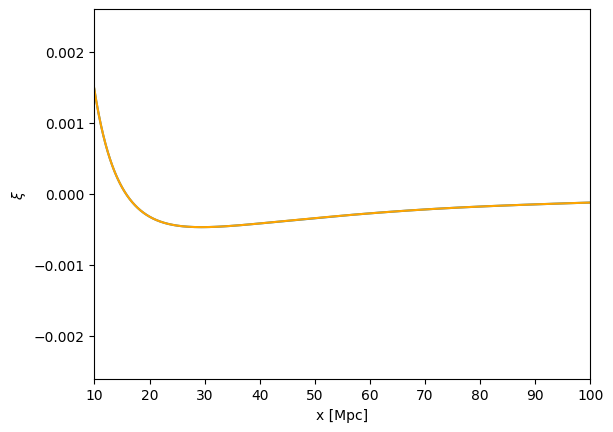

In [27]:
plt.plot(xfine, xi_fid)
plt.plot(np.logspace(-3,3,1000), xi_fid_func(np.logspace(-3,3,1000)), color='orange')
plt.xlim([10,10**2])
plt.ylim([-.0026,.0026])
plt.xlabel("x [Mpc]")
plt.ylabel(r"$\xi$")

In [28]:
C_0_mat_binned = est.c0(xi_fid_func, delta_x_matrix_binned)
C_0_mat = est.c0(xi_fid_func, delta_x_matrix)

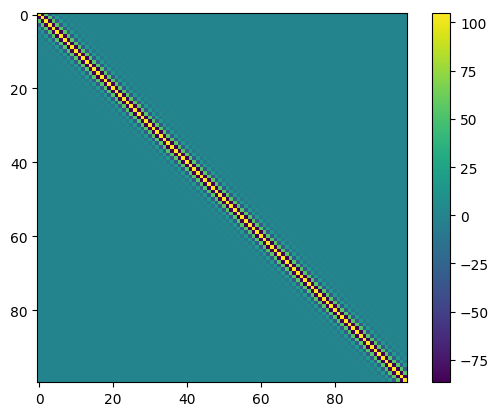

In [29]:
C_0_invmat = np.linalg.inv(C_0_mat)

C_0_invmat_binned = np.linalg.inv(C_0_mat_binned)
plt.imshow(C_0_invmat_binned[0:100,0:100])
plt.colorbar()

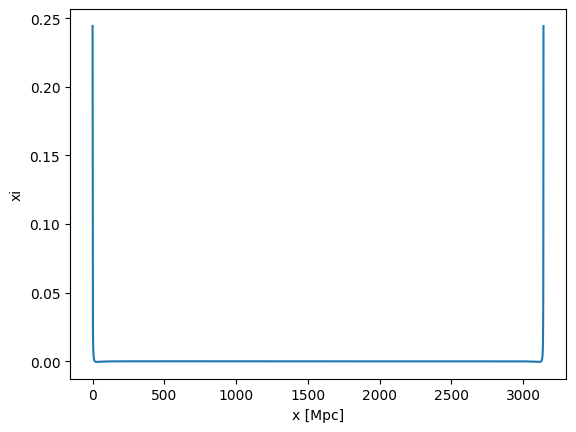

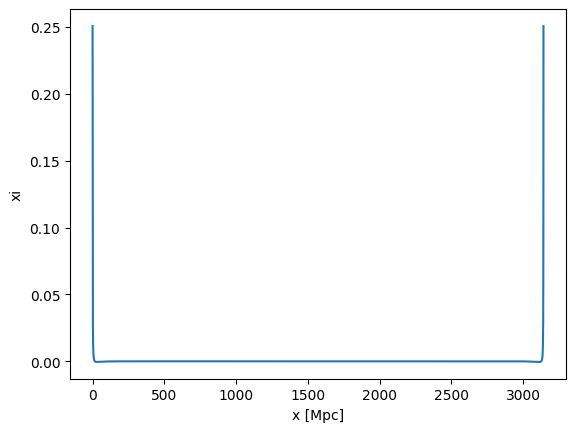

<Figure size 640x480 with 0 Axes>

In [30]:
# # check the fiducial signal
S_fiducial_b = est.s_fid(arinyo, zs[0], arinyo_params, delta_x_matrix_binned, pix_spacing_b, plot=True)
S_fiducial   = est.s_fid(arinyo, zs[0], arinyo_params, delta_x_matrix, pix_spacing, plot=True)

Text(0.5, 0.98, 'Relationship of convolved signal matrix to theoretical one')

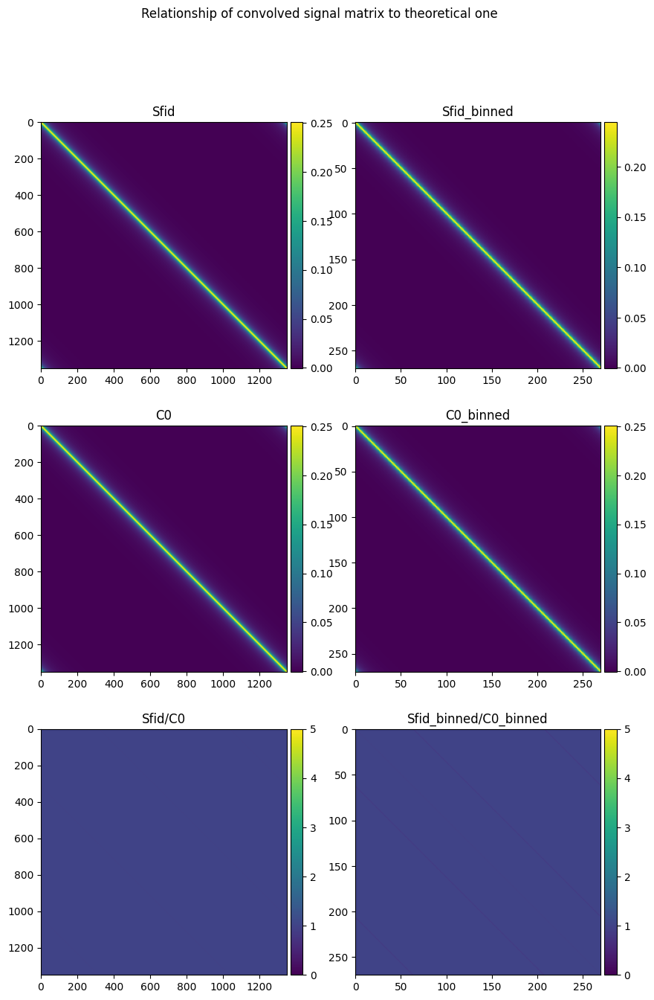

In [31]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax= plt.subplots(3, 2, figsize=(10,15))
im1 = ax[0,0].imshow(S_fiducial)
im2 = ax[0,1].imshow(S_fiducial_b)
im4 = ax[1,0].imshow(C_0_mat)
im3 = ax[1,1].imshow(C_0_mat_binned)
im5 = ax[2,0].imshow(S_fiducial / C_0_mat, vmin=0, vmax=5)
im6 = ax[2,1].imshow(S_fiducial_b / C_0_mat_binned, vmin=0, vmax=5)
# colorbar for all
divider = make_axes_locatable(ax[0,0])
cax1 = divider.append_axes("right", size="5%", pad=0.05)

divider = make_axes_locatable(ax[0,1])
cax2 = divider.append_axes("right", size="5%", pad=0.05)

divider = make_axes_locatable(ax[1,0])
cax3 = divider.append_axes("right", size="5%", pad=0.05)

divider = make_axes_locatable(ax[1,1])
cax4 = divider.append_axes("right", size="5%", pad=0.05)

divider = make_axes_locatable(ax[2,0])
cax5 = divider.append_axes("right", size="5%", pad=0.05)

divider = make_axes_locatable(ax[2,1])
cax6 = divider.append_axes("right", size="5%", pad=0.05)

fig.colorbar(im1, cax=cax1, orientation='vertical')
fig.colorbar(im2, cax=cax2, orientation='vertical')
fig.colorbar(im3, cax=cax3, orientation='vertical')
fig.colorbar(im4, cax=cax4, orientation='vertical')
fig.colorbar(im5, cax=cax5, orientation='vertical')
fig.colorbar(im6, cax=cax6, orientation='vertical')
titles = ['Sfid', 'Sfid_binned', 'C0', 'C0_binned', 'Sfid/C0', 'Sfid_binned/C0_binned']
for i in range(3):
    for j in range(2):
        ax[i,j].set_title(titles[i*2+j])
plt.suptitle("Relationship of convolved signal matrix to theoretical one")


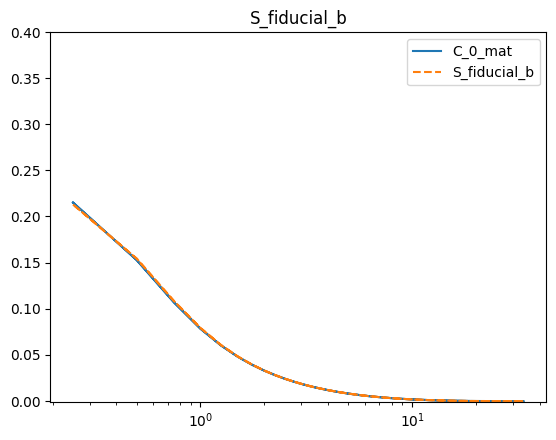

In [32]:
# plot the cross-diagonal to take a slice through the matrices (removing redundant info)
def plot_cross_diag(matrix, sep_matrix, title, c, linestyles=['solid', '--','dotted']):
    # n = matrix.shape[0]
    # cross_diag = [matrix[i, n-i-1] for i in range(n)]
    # cross_diag_sep_matrix = [sep_matrix[i, n-i-1] for i in range(n)]
    cross_diag_sep_matrix = np.diag(np.fliplr(sep_matrix))
    cross_diag = np.diag(np.fliplr(matrix))
    plt.semilogx(cross_diag_sep_matrix, cross_diag, label=title, linestyle=linestyles[c])
    # plt.xlim([0,])
    plt.ylim([-.001, .4])
    # plt.title(title)
    # plt.show()
    return cross_diag_sep_matrix
def plot_off_diag(matrix, sep_matrix, title, c, linestyles=['solid', '--','dotted']):
    off_diag = matrix[0, 1:]
    off_diag_sep_matrix = sep_matrix[0, 1:]
    plt.semilogx(off_diag_sep_matrix, off_diag, label=title, linestyle=linestyles[c])
    # plt.xlim([0,])
    plt.ylim([-.001, .4])
    plt.title(title)
    # plt.show()
    return off_diag_sep_matrix

plot_off_diag(C_0_mat_binned, delta_x_matrix_binned, "C_0_mat",0)
# plot_cross_diag(C_0_mat_unbinned, delta_x_matrix, "C_0_mat_unbinned")
plot_off_diag(S_fiducial_b, delta_x_matrix_binned, "S_fiducial_b",1)
# plot_cross_diag(S_fiducial, delta_x_matrix, "S_fiducial",2)
plt.legend()


Estimate $P_{\times}$

In [36]:
kbin_centers, theta_est_px, F_alpha_beta_px, Lalpha_px, Npairs = est.estimate_px(Np_b, delta_x_matrix_binned, pix_spacing_b, delta_flux_b, m_offsets, n_offsets, kbin_est[:30], S_fiducial_b, C_0_invmat_binned, approx_fisher=True)

Starting P1D.
center of kbins:  [0.0, 0.0930842267730309, 0.1861684535460618, 0.27925268031909267, 0.3723369070921236, 0.46542113386515443, 0.5585053606381853, 0.6515895874112162, 0.7446738141842472, 0.837758040957278, 0.9308422677303089, 1.0239264945033397, 1.1170107212763707, 1.2100949480494017, 1.3031791748224324, 1.3962634015954634, 1.4893476283684943, 1.5824318551415253, 1.675516081914556, 1.768600308687587, 1.8616845354606177, 1.9547687622336487, 2.0478529890066794, 2.1409372157797106, 2.2340214425527414, 2.327105669325772, 2.4201898960988033, 2.513274122871834, 2.606358349644865, 2.6994425764178955]
Getting derivative matrices.
Starting loop through data.
This k took 4.473618030548096 seconds
This k took 5.443544149398804 seconds
This k took 4.831731081008911 seconds
This k took 4.136496067047119 seconds
This k took 5.678575754165649 seconds
This k took 6.359045028686523 seconds
This k took 4.702472925186157 seconds
This k took 4.980628967285156 seconds
This k took 5.32476210594

Estimate $P_{1D}$.

In [157]:
kbin_centers, theta_est_p1d, F_alpha_beta_p1d, Lalpha_P1D = est.estimate_p1d(Np_b, delta_x_matrix_binned, pix_spacing_b, delta_flux_b, kbin_est, np.zeros(S_fiducial_b.shape), C_0_invmat_binned)


Starting P1D.
center of kbins:  [0.0, 0.0930842267730309, 0.1861684535460618, 0.27925268031909267, 0.3723369070921236, 0.46542113386515443, 0.5585053606381853, 0.6515895874112162, 0.7446738141842472, 0.837758040957278, 0.9308422677303089, 1.0239264945033397, 1.1170107212763707, 1.2100949480494017, 1.3031791748224324, 1.3962634015954634, 1.4893476283684943, 1.5824318551415253, 1.675516081914556, 1.768600308687587, 1.8616845354606177, 1.9547687622336487, 2.0478529890066794, 2.1409372157797106, 2.2340214425527414, 2.327105669325772, 2.4201898960988033, 2.513274122871834, 2.606358349644865, 2.6994425764178955]
Getting derivative matrices.
Starting loop through data.
kbins are = [-0.04654211338651545, 0.04654211338651545], [-0.04654211338651545, 0.04654211338651545]; computing second derivative
kbins are = [-0.04654211338651545, 0.04654211338651545], [0.04654211338651545, 0.13962634015954634]; computing second derivative
kbins are = [-0.04654211338651545, 0.04654211338651545], [0.1396263401

# Do the P1D skewer measurements

In [37]:
# reshape delta_flux_k to be Ns x Np again
delta_flux_b_flat = np.ma.masked_array(np.reshape(delta_flux_b, (nskew, Np_b)))

# for those that aren't nan:
pk_all = []
for i in range(len(delta_flux_b_flat)):
    if not np.isnan(delta_flux_b_flat[i]).any():
        delta_flux_k = np.fft.rfft(delta_flux_b_flat[i])
        pk_all.append(abs(delta_flux_k)**2*pix_spacing_b/Np_b)
# delta_flux_k = np.fft.rfft(delta_flux_b_flat, axis=1)
# pk_all=abs(delta_flux_k)**2
pk_avg = np.average(np.array(pk_all), axis=0) # average over all skewers in this axis


Text(0.5, 1.0, 'Pixelization = 0.25 Mpc')

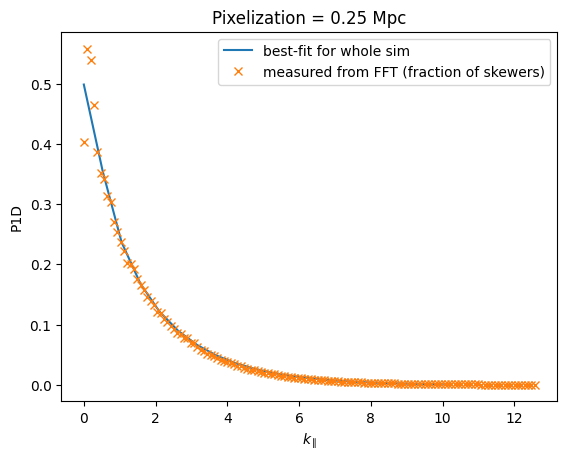

In [38]:
# plt.plot(kpar[1:5], P_kpar_est, 'o', label='estimate')
# plt.plot(kpar[1:], p1d[1:], label='fiducial')
# plt.plot(kpar[1:13], 2*p1d[1:13], label='2x best-fit for whole sim')

plt.plot(np.linspace(0, 10, 20), p1d, label='best-fit for whole sim')
plt.plot(kpar_b, pk_avg, marker = 'x', linestyle='none', label='measured from FFT (fraction of skewers)')
plt.legend()
plt.ylabel("P1D")
plt.xlabel("$k_\parallel$")
plt.title("Pixelization = {:.2f} Mpc".format(pix_spacing_b))

# Examine the results

Bin the P1D model (initial guess) to match the binning of the $\Delta P_{1D}$ estimates

In [41]:
len(kbin_centers)

30

In [44]:
# window P1D to match the fiducial guess, and bin it to match the large k bins
# p1d_fid_lrgbins = np.zeros(Nbin_lrg)
# p1d_fine_windowed = p1d_fine * est.w_k(kfine, pix_spacing_b)**2

def bin_model(kfine, p1d_fine, kbins, nbin):
    p1d_fid = np.zeros(nbin)
    for i in range(nbin):
        kbin = kbins[i]
        kbin_indices = np.where((kfine > kbin[0]) & (kfine < kbin[1]))
        p1d_fid[i] = np.mean(p1d_fine[kbin_indices])
    return p1d_fid
Nbin = len(kbin_centers)
p1d_fid = bin_model(kfine, p1d_fine, kbin_est, Nbin)

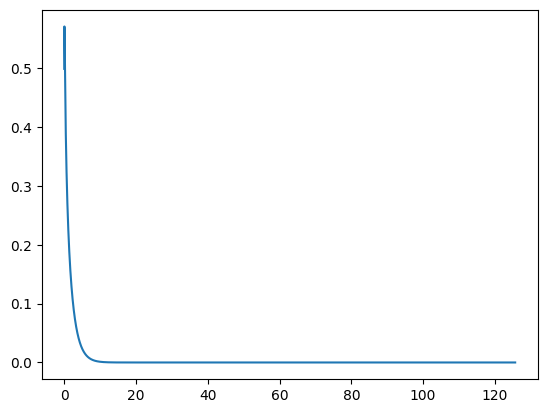

In [45]:
plt.plot(kfine, p1d_fine)

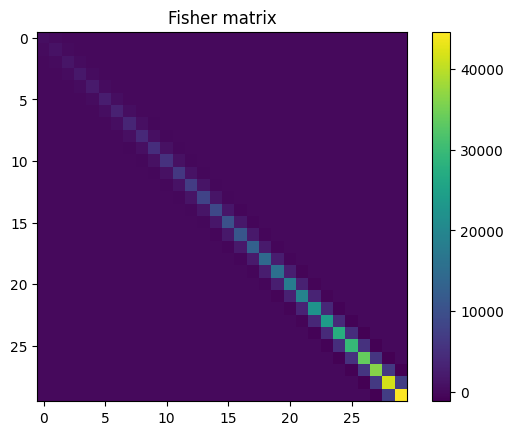

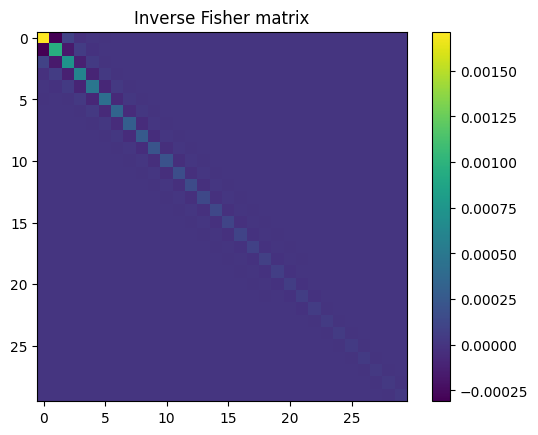

<Figure size 640x480 with 0 Axes>

In [46]:
plt.imshow(F_alpha_beta_px)
plt.colorbar()
plt.title("Fisher matrix")
plt.show()
plt.clf()

F_inv_px = np.linalg.inv(F_alpha_beta_px)
plt.imshow(F_inv_px)
plt.colorbar()
plt.title("Inverse Fisher matrix")
plt.show()
plt.clf()

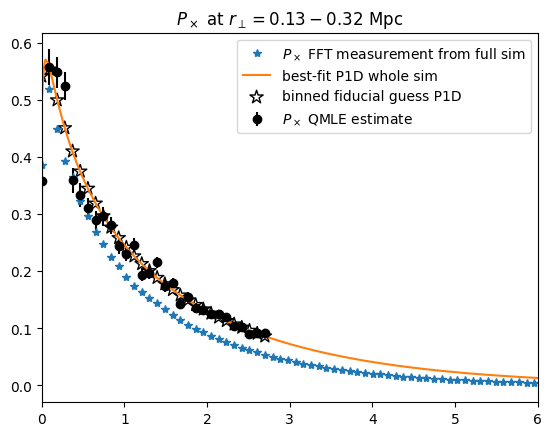

In [47]:
plt.errorbar(kbin_centers,theta_est_px+p1d_fid, yerr=np.sqrt(np.diag(F_inv_px)), fmt='o', label=r'$P_\times$ QMLE estimate', color='black')
plt.plot(kpar_meas[0:65], Px_meas_0, '*', label=r'$P_\times$ FFT measurement from full sim')
plt.plot(kfine, p1d_fine, label='best-fit P1D whole sim')
plt.scatter(kbin_centers, p1d_fid, label='binned fiducial guess P1D',marker="*", s=100, edgecolors='black',facecolor='none')

plt.title(r"$P_\times$ at $r_\perp=0.13-0.32$ Mpc")
plt.xlim([0,6])
plt.legend()

Text(0.5, 0, '$k_\\parallel$ [Mpc$^{-1}$]')

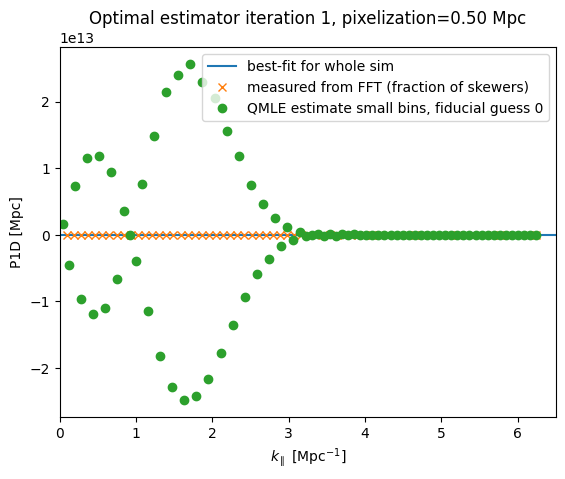

In [354]:
# plt.plot(kpar[1:5], P_kpar_est, 'o', label='estimate')
# plt.plot(kpar[1:], p1d[1:], label='fiducial')
# plt.plot(kpar[1:13], 2*p1d[1:13], label='2x best-fit for whole sim')

plt.plot(np.linspace(0, 10, 20), p1d, label='best-fit for whole sim')
plt.plot(kpar_b[1:], pk_avg[1:], marker = 'x', linestyle='none', label='measured from FFT (fraction of skewers)')

# plt.plot(kpar[1:9], p1d[1:9]+theta_est, 'o', label='QMLE estimate')
plt.plot(kbin_centers_small,theta_est_small, 'o', label='QMLE estimate small bins, fiducial guess 0') # /4.8
# plt.plot(kbin_centers,theta_est, 'o', label='QMLE estimate midsize bins') # /4.8
# plt.plot(kbin_centers_lrg,theta_est_lrg, 'o', label='QMLE estimate, fiducial guess 0', alpha=.6, color='red') # /4.8

# plt.plot(kbin_centers_lrg, p1d_fid_lrgbins+theta_est_lrg_subfid, 'o', label='QMLE estimate, fiducial guess P1D', alpha=.6, color='green') # /4.8
# plt.plot(kbin_centers, arinyo.P1D_Mpc(zs[0], np.asarray(kbin_centers), parameters=arinyo_params)+ theta_est, 'o', label='QMLE estimate')
# plt.ylim([0.,1.3])
# plt.scatter(kbin_centers_small, p1d_fid_smallbins, label='binned fiducial guess P1D',marker="*", s=100, edgecolors='black',facecolor='none')
plt.xlim([0,6.5])
plt.legend()
plt.title("Optimal estimator iteration 1, pixelization={:.2f} Mpc".format(pix_spacing_b))
plt.ylabel("P1D [Mpc]")
plt.xlabel("$k_\parallel$ [Mpc$^{-1}$]")

# how do we get the $p_\alpha$ estimates?
(1) Make a first guess for $p_\alpha$

(2) At every iteration compute the covariance matrix using the previous estimates for $p_\alpha$

The covariance matrix is $C = S + N$


(3) Compute $d_\alpha$, $b_\alpha$, $t_\alpha$ as in Naim 4,5,6 -- these have the observed $\delta_F$ vectors

(4) Compute

$$ \hat{p}_\alpha^{(X+1)} = \Sigma_{\alpha'} \frac{1}{2}F^{-1}_{\alpha \alpha'} (d_{\alpha'}-b_{\alpha'}-t_{\alpha'})$$

which is effectively giving the inverse-variance-weighted average of the residuals at each iteration.

(5)  Compute Fisher matrix. Note that this needs to consider all redshift bins that the spectrum spans.

(6) Check for convergence using eqns in 3.3 (Naim)

Notes from Andreu's paper:
Make the fiducial power spectrum P1D
